# Exploratory Data Analysis

## Imports

In [1]:
import pandas as pd
import numpy as np
import os
import matplotlib.pyplot as plt
import seaborn as sns
from sklearn.decomposition import PCA
from sklearn.preprocessing import scale

from library.sb_utils import save_file

## Load The Data

In [2]:
batch_data = pd.read_csv('./data/batch_data_clean.csv')
recipe_data = pd.read_csv('./data/recipe_data_clean.csv')

In [3]:
print(batch_data.info())

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 1123 entries, 0 to 1122
Data columns (total 13 columns):
 #   Column                 Non-Null Count  Dtype  
---  ------                 --------------  -----  
 0   rcp_id                 1123 non-null   int64  
 1   base_malt_pct          1122 non-null   float64
 2   Boil Kettle            834 non-null    float64
 3   Whirlpool              834 non-null    float64
 4   Fermenter              834 non-null    float64
 5   Total Hops             834 non-null    float64
 6   fermenter_temperature  1106 non-null   float64
 7   cu_low                 1068 non-null   float64
 8   cu_high                1102 non-null   float64
 9   cu_setpoint            1115 non-null   float64
 10  pre_run_dump_volume    557 non-null    float64
 11  original_gravity       1123 non-null   float64
 12  clar_eff               1123 non-null   float64
dtypes: float64(12), int64(1)
memory usage: 114.2 KB
None


In [4]:
print(recipe_data.info())

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 270 entries, 0 to 269
Data columns (total 13 columns):
 #   Column                 Non-Null Count  Dtype  
---  ------                 --------------  -----  
 0   rcp_id                 270 non-null    int64  
 1   base_malt_pct          269 non-null    float64
 2   Boil Kettle            99 non-null     float64
 3   Whirlpool              99 non-null     float64
 4   Fermenter              99 non-null     float64
 5   Total Hops             99 non-null     float64
 6   fermenter_temperature  267 non-null    float64
 7   cu_low                 260 non-null    float64
 8   cu_high                263 non-null    float64
 9   cu_setpoint            264 non-null    float64
 10  pre_run_dump_volume    156 non-null    float64
 11  original_gravity       270 non-null    float64
 12  clar_eff               270 non-null    float64
dtypes: float64(12), int64(1)
memory usage: 27.5 KB
None


## Explore The Data

## Visualizing High Dimensional Data with PCA

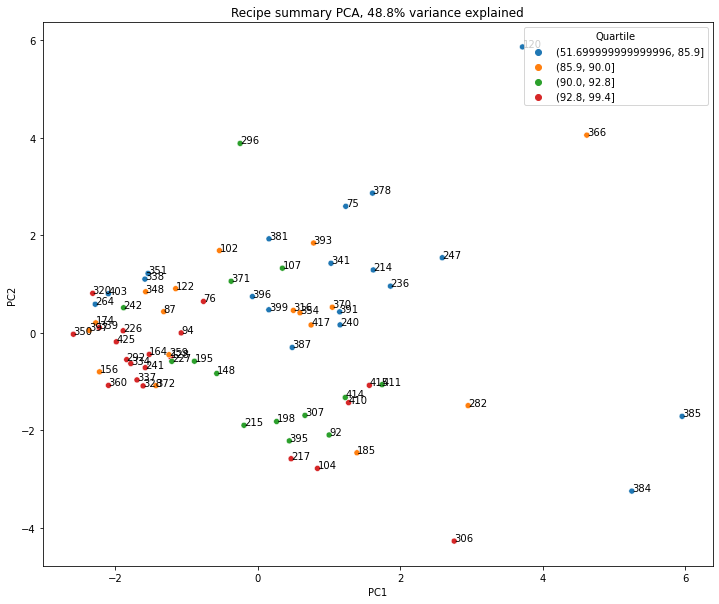

In [9]:
# A "quick" PCA with clarification efficiencies color coded by quartile
# There does seem to be some grouping, but like the box plot above plenty of
# overlap among quartiles and in-group variance.
# Also, less than half the variance is explained by the dataset...

recipe_data_scale = recipe_data.dropna().set_index('rcp_id')
recipe_data_index = recipe_data_scale.index
recipe_data_columns = recipe_data_scale.columns
recipe_data_scale = scale(recipe_data.dropna())

recipe_scaled_df = pd.DataFrame(recipe_data_scale, columns=recipe_data.columns)

recipe_pca = PCA().fit(recipe_data_scale)
recipe_pca_x = recipe_pca.transform(recipe_data_scale)
pc_var = 100 * recipe_pca.explained_variance_ratio_.cumsum()[1]

recipe_avg_eff = batch_data.groupby('rcp_id')['clar_eff'].mean()
pca_df = pd.DataFrame({'PC1': recipe_pca_x[:, 0], 'PC2':recipe_pca_x[:, 1]}, index=recipe_data_index)

pca_df = pd.concat([pca_df, recipe_avg_eff], axis=1)
pca_df['Quartile'] = pd.qcut(pca_df.clar_eff, q=4, precision=1)
pca_df = pca_df.dropna()

x = pca_df.PC1
y = pca_df.PC2
recipe = pca_df.index
plt.subplots(figsize=(12, 10))
# Note the argument below to make sure we get the colours in the ascending
# order we intuitively expect!
sns.scatterplot(x=x, y=y, hue='Quartile', 
                hue_order=pca_df.Quartile.cat.categories, data=pca_df)
for s, x, y in zip(recipe, x, y):
    plt.annotate(s, (x, y))   
plt.title(f'Recipe summary PCA, {pc_var:.1f}% variance explained');

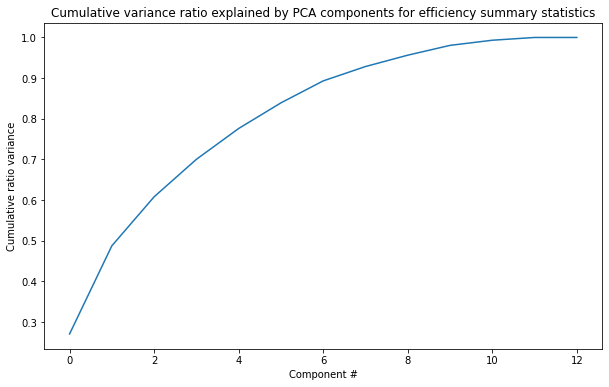

In [10]:
#Plotting the cumulative variance ratio explained by PCA components for efficiency
plt.subplots(figsize=(10, 6))
plt.plot(recipe_pca.explained_variance_ratio_.cumsum())
plt.xlabel('Component #')
plt.ylabel('Cumulative ratio variance')
plt.title('Cumulative variance ratio explained by PCA components for efficiency summary statistics');

The first two components barely seem to account for half of the variance, verifying the PCA above.

## Looking at Distribution of Target Feature

In [11]:
#Calculate the average 'clar_eff' by recipe
recipe_avg_eff = batch_data.groupby('rcp_id')['clar_eff'].mean()
recipe_avg_eff.head()

rcp_id
75    84.580859
76    93.025291
78    94.587480
87    89.347707
89    97.821936
Name: clar_eff, dtype: float64

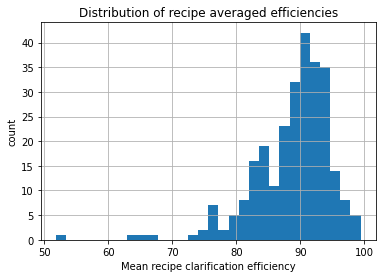

In [12]:
#And plot a histogram of average recipe clarifications
recipe_avg_eff.hist(bins=30)
plt.title('Distribution of recipe averaged efficiencies')
plt.xlabel('Mean recipe clarification efficiency')
plt.ylabel('count');

## Feature correlation heatmap

<AxesSubplot:>

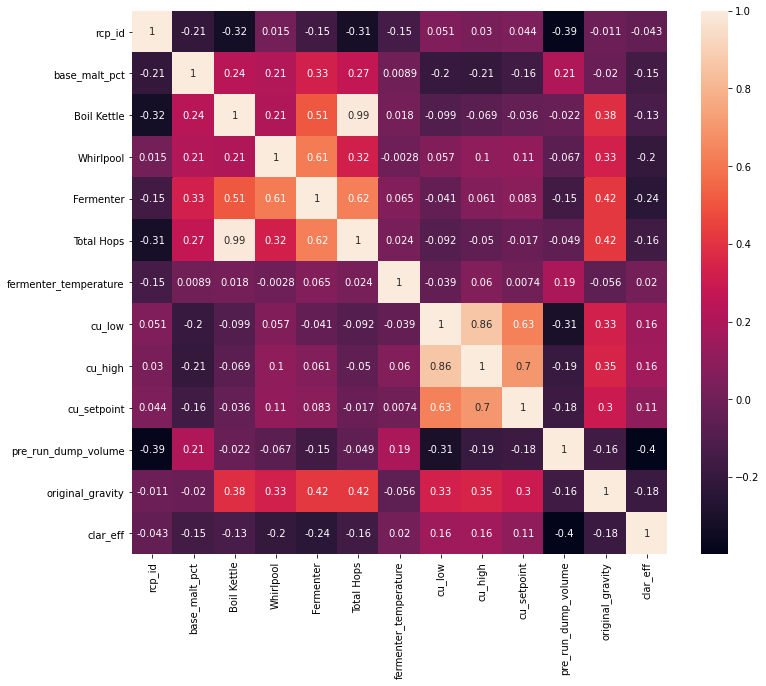

In [24]:
#Generating correlation heatmap for batch-based data
plt.subplots(figsize=(12,10))
sns.heatmap(batch_data.corr(), annot=True)

<AxesSubplot:>

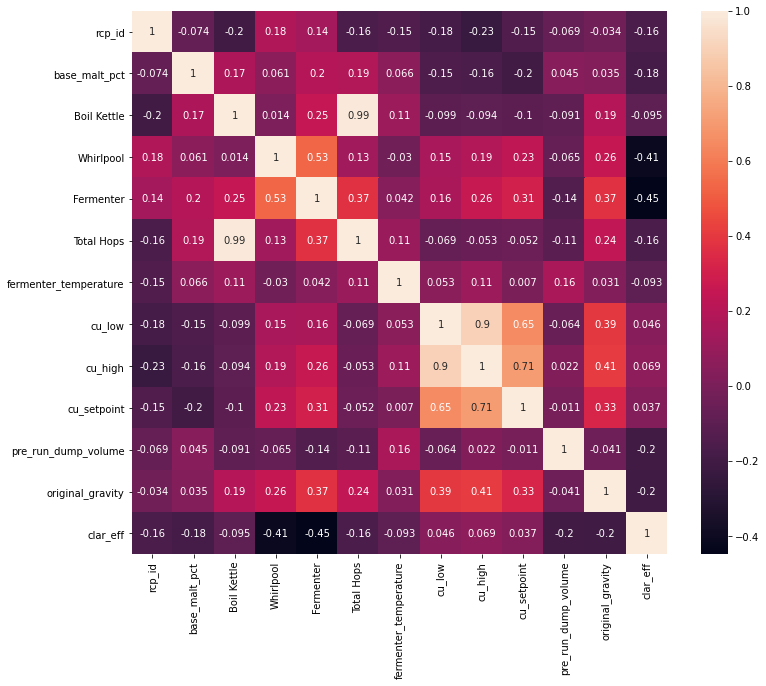

In [25]:
#Generating correlation heatmap for recipe-based data
plt.subplots(figsize=(12,10))
sns.heatmap(recipe_data.corr(), annot=True)

While they both seem to tell the same story with correlation, the batch-based data is much more pronounced in correlation. This is presumably due to the much higher sample size of the batch data. Interestingly, however, recipe data is showing stronger negative correlation with efficiency (clar_eff) and fermenter/whirlpool hops added. Further, the boil kettle and total hops being highly correlated makes sense, as in most recipes the boil kettle hops make up the bulk of total hop additions. 

## Scatterplots of numeric features against clarification efficiency

In [15]:
# define useful function to create scatterplots of ticket prices against desired columns
def scatterplots(dataset, columns, ncol=None, figsize=(15, 8)):
    if ncol is None:
        ncol = len(columns)
    nrow = int(np.ceil(len(columns) / ncol))
    fig, axes = plt.subplots(nrow, ncol, figsize=figsize, squeeze=False)
    fig.subplots_adjust(wspace=0.5, hspace=0.6)
    for i, col in enumerate(columns):
        ax = axes.flatten()[i]
        ax.scatter(x = col, y = 'clar_eff', data=dataset, alpha=0.5)
        ax.set(xlabel=col, ylabel='Clarification Efficiency')
    nsubplots = nrow * ncol    
    for empty in range(i+1, nsubplots):
        axes.flatten()[empty].set_visible(False)

In [16]:
#Code task 13#
#Use a list comprehension to build a list of features from the columns of `ski_data` that
#are _not_ any of 'Name', 'Region', 'state', or 'AdultWeekend'
features = [feature for feature in batch_data.columns if feature not in ['rcp_id', 'clar_eff']]

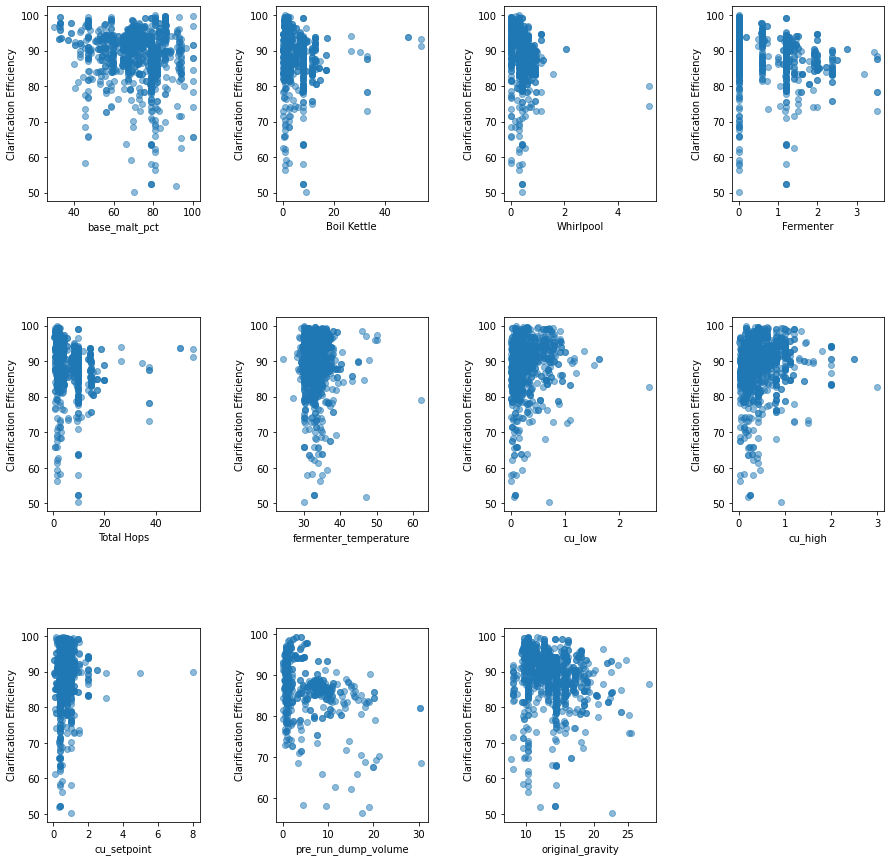

In [17]:
scatterplots(batch_data, features, ncol=4, figsize=(15, 15))

In [18]:
#Code task 13#
#Use a list comprehension to build a list of features from the columns of `ski_data` that
#are _not_ any of 'Name', 'Region', 'state', or 'AdultWeekend'
features = [feature for feature in recipe_data.columns if feature not in ['clar_eff']]

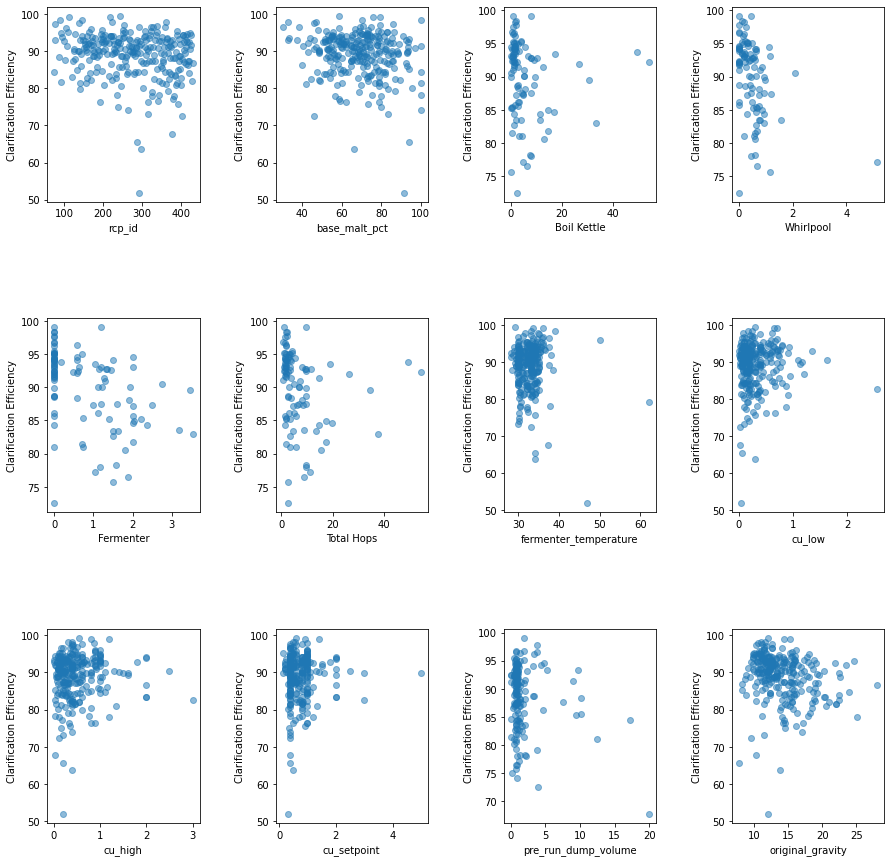

In [19]:
scatterplots(recipe_data, features, ncol=4, figsize=(15, 15))

## Now that I've learned about this, the Seaborn Pairplot

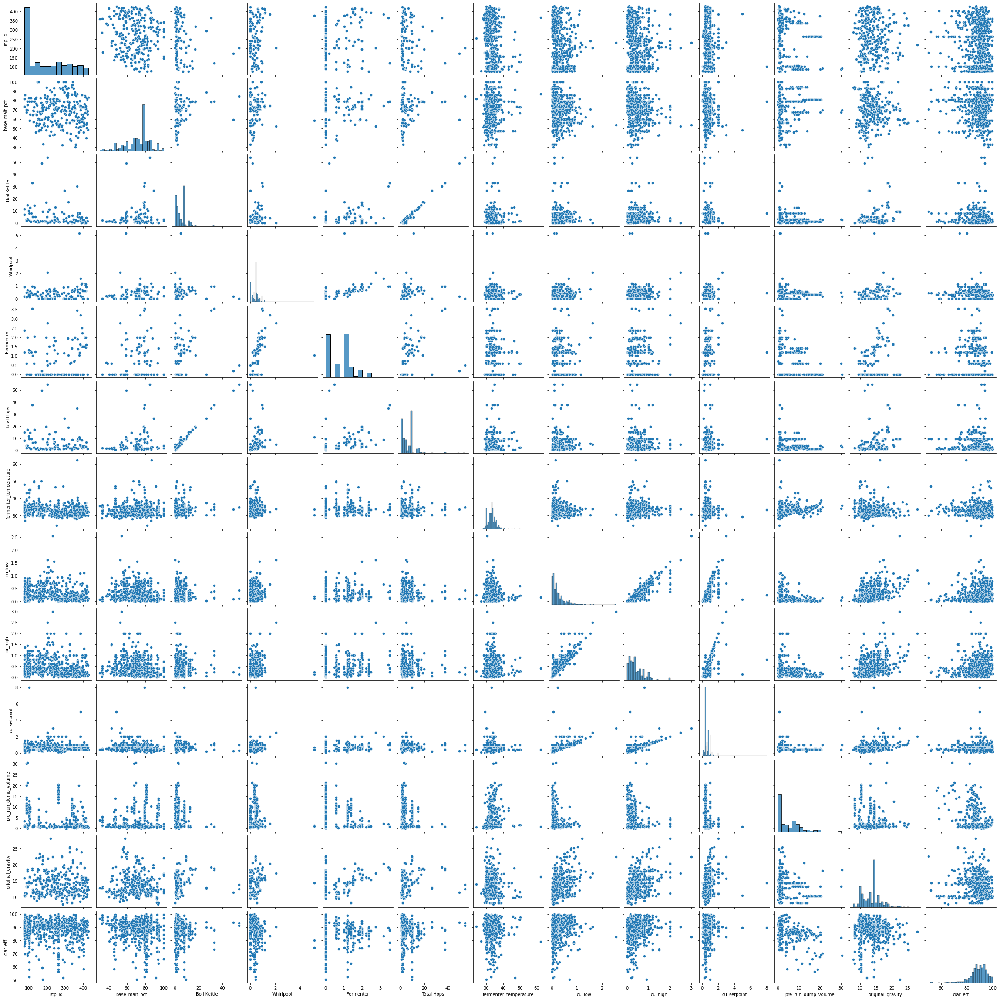

In [20]:
#Create a pairplot for all numeric variables in batch data
sns.pairplot(batch_data,  palette='Set1')
plt.show()

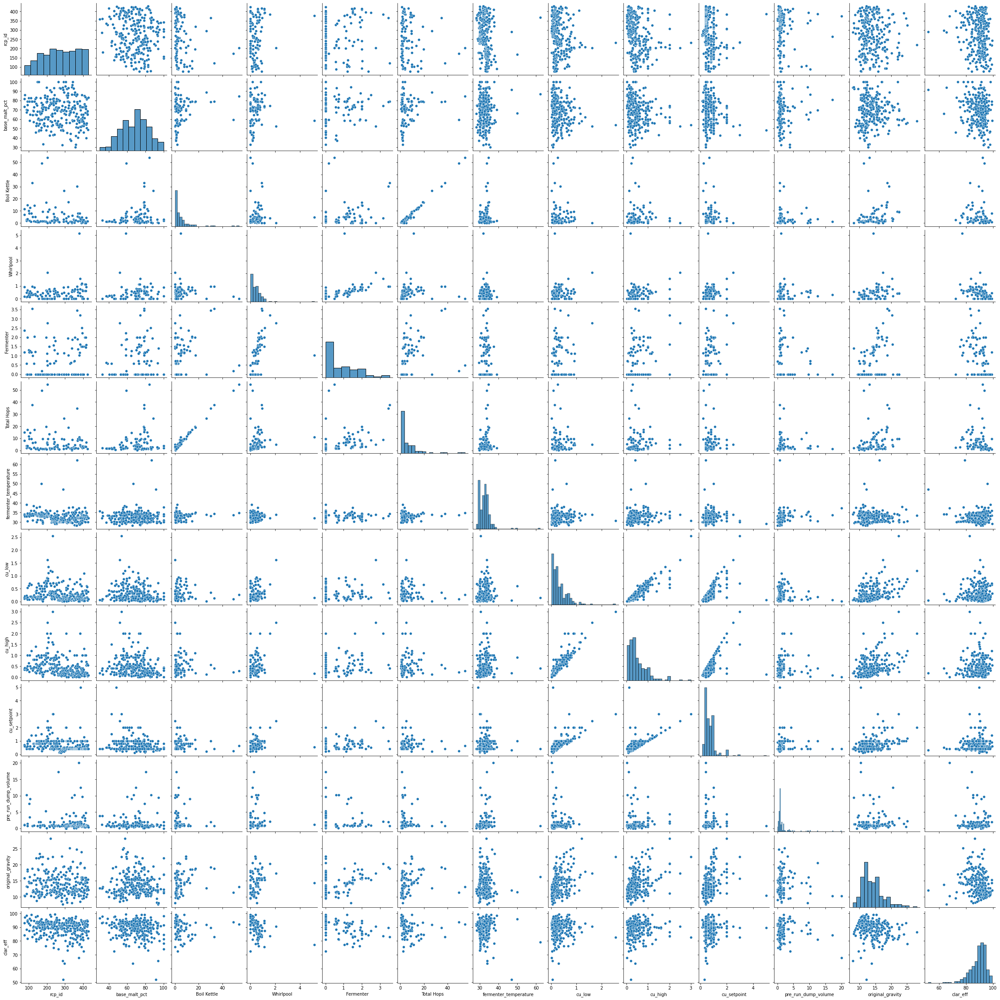

In [22]:
#Create a pairplot for all numeric variables in batch data
sns.pairplot(recipe_data,  palette='Set1')
plt.show()

## Visualize Notable or Interesting Correlations

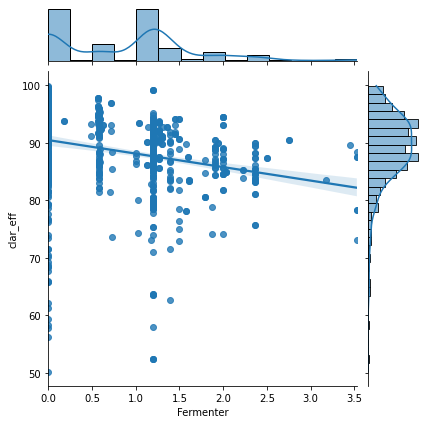

In [26]:
#Plot relationship between Fermenter Hops (dry hop) and clarification efficiency in batch data
sns.jointplot(x='Fermenter', y='clar_eff', data=batch_data, kind="reg");

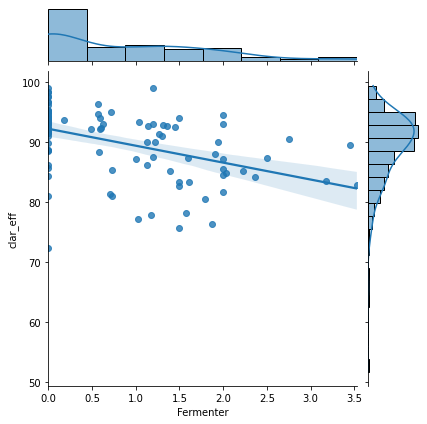

In [27]:
#Plot relationship between Fermenter Hops (dry hop) and clarification efficiency in recipe data
sns.jointplot(x='Fermenter', y='clar_eff', data=recipe_data, kind="reg");

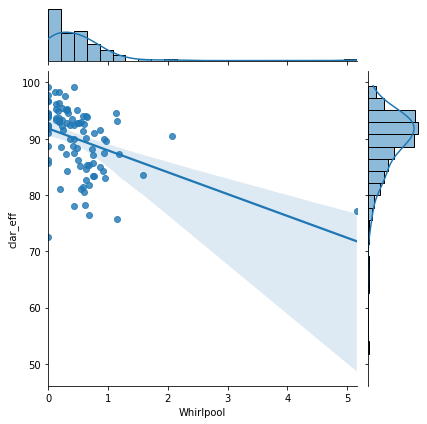

In [28]:
#Plot relationship between Whirlpool Hops and clarification efficiency in recipe data
sns.jointplot(x='Whirlpool', y='clar_eff', data=recipe_data, kind="reg");